<a href="https://colab.research.google.com/github/bianca-isaac/Repositorio/blob/main/EN2_NBA_2019_20_Team_correlation_matrix_and_Descriptive_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Data Analysis - NBA 2019-20

# <p align="center"> [![LinkedIn](https://img.shields.io/badge/LinkedIn-biancaisaac-blue.svg)](https://www.linkedin.com/in/bianca-rodrigues-isaac/) [![GitHub](https://img.shields.io/badge/GitHub-biancaisaac-orange)](https://github.com/bianca-isaac) [![Medium](https://img.shields.io/badge/Medium-biancaisaac-green)](https://biancarisaac.medium.com/)

> The goal of this project is to perform a **descriptive statistical analysis** focused on the correlation between variables in the scoring data for **NBA - National Basketball Association** teams during the 2019-20 season.

# <p align="center">**NBA**

<p align="center"><img src="https://github.com/bianca-isaac/Repositorio/blob/main/Basketball_Analytics/Images/basketball-NBA.jpg?raw=true" height="500px"></p>





---
---


## **Brief history**


Data analysis in sports is becoming increasingly important for better team performance. 

One of the great teams that have started a deeper data analysis is the Houston Rockets. 

The analysis is done both for game variables and physical data analysis of the players. The team starts analyzing since the pre-season studying both their team and the opposing teams. 

During the game the coaches and staffs seek information to be able to perform more efficient combinations of players on the court. 

It is possible to analyze the profile of the opposing player who would be more interesting to make a foul because the probability of the player missing the free throw is higher and this mistake can be fundamental in the outcome of the match. 

The analyses are also done on college teams, thus preparing the list with the best players for the *draft*.

It is very important to know the environment that will perform the analysis because much more important than knowing how to make amazing calculations is to know how to use them to optimize the results. 


---
---


 # Sumário <a name="sumario"></a>

1. [O que é Análise descritiva](#paragraph1)
2. [Análise de ddos dados](#paragraph2)
  1. [Análise de dados "TEAM"](#subparagraph1)
    1. [Boxscores = Dicionário de variáveis no Basquete](#subsubparagraph1)
    2. [Explorando os dados](#subsubpragraph2)
    3. [Exploratory Questions](#subsubparagraph3)
    4. [Correlaçao entre as variáveis](#subsubparagraph4)
  2. [Pandas - Profiling](#subparagraph2)
3. [Conclusões](#paragraph3)
4. [Considerações finais](#paragraph4)
5. [Curiosidade](#paragraph5)

---

---

## **What is Descriptive Analysis**<a name="paragraph1"> </a> ([&uArr;](#summary))

Data analysis is done in order to strategize, plan, and pursue desired results. 

Descriptive statistics aims, through various techniques, to describe and summarize data in order to facilitate understanding and aid problem solving. 

It seeks to describe the trends in the data. It is through graphs, frequency tables, measures such as mean, median, standard deviation, percentiles and quartiles. 

Analysis covers the entire process of collecting, organizing, tabulating and describing data. 
It is a fundamental step for any analysis within Data Science. 



---
---


## Data Analysis <a name="paragraph2"> </a> ([&uArr;](#summary))


**Dados e blibliotecas**

The data used for this analysis is from the 2019–20 NBA Season. The site for all NBA stats is  [Basketball-Reference](https://www.basketball-reference.com/).  

The data about TEAMS and  WINS you can find [here](https://www.basketball-reference.com/leagues/NBA_2020.html#all_team-stats-base) and the data about PLAYERS [here](https://www.basketball-reference.com/leagues/NBA_2020_totals.html)

In [30]:
# Imports for data manipulation, visualization and analysis
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

sns.set()

In [31]:
# Importing player data
df_player = pd.read_csv('https://raw.githubusercontent.com/bianca-isaac/Repositorio/main/Basketball_Analytics/Data/players_stats_2019_20')

# Importing team data
df_team = pd.read_csv('https://raw.githubusercontent.com/bianca-isaac/Repositorio/main/Basketball_Analytics/Data/team_stats_2019_20')

# importing wins by team
df_win = pd.read_csv('https://raw.githubusercontent.com/bianca-isaac/Repositorio/main/Basketball_Analytics/Data/wins_NBA_2019-2020')

In [32]:
# Merging Dataframes df_team and df_win
df_team2 = df_team.merge(df_win, on='Team', how='inner' )
df_team2.columns

Index(['Rk', 'Team', 'G', 'MP', 'FG', 'FGA', 'FG%', '3P', '3PA', '3P%', '2P',
       '2PA', '2P%', 'FT', 'FTA', 'FT%', 'ORB', 'DRB', 'TRB', 'AST', 'STL',
       'BLK', 'TOV', 'PF', 'PTS', 'W', 'L', 'W/L%', 'GB', 'PS/G', 'PA/G',
       'SRS', 'C'],
      dtype='object')

### Data Analysis **"TEAM "**<a name="subparagraph1"> </a> ([&uArr;](#summary))

To start our analysis on the teams, let's check the variable names, check the amount of data, whether or not there are missing values. 


In [33]:
# Column names
df_team2.columns

Index(['Rk', 'Team', 'G', 'MP', 'FG', 'FGA', 'FG%', '3P', '3PA', '3P%', '2P',
       '2PA', '2P%', 'FT', 'FTA', 'FT%', 'ORB', 'DRB', 'TRB', 'AST', 'STL',
       'BLK', 'TOV', 'PF', 'PTS', 'W', 'L', 'W/L%', 'GB', 'PS/G', 'PA/G',
       'SRS', 'C'],
      dtype='object')

**Quantos atributos e quantas entradas o nosso conjunto de dados possui? Quais os tipos das variáveis?**

In [34]:
# show volume of data 
# lines
print("Number of observations:\t {}".format(df_team2.shape[0]))
# column
print("Variables:\t{}\n".format(df_team2.shape[1]))

Number of observations:	 30
Variables:	33



#### **Boxscore = Dictionary of Variables in Basketball** <a name="subsubparagraph1"> 


A "boxscore" is a table in which all the main events of a basketball match are counted. 

It can be followed in real time, which helps in decision making at the moment of the match, or it can be analyzed after the match in order to tell the story of what happened inside the court.

From it we can verify some reasons for victories and defeats. 

As stated earlier in this project, the goal is to analyze this data per team and per player throughout the 2019-2020 season. 



---

|Variables| Description ||
|----------------|-------------------------------|-----------------------------|
|RK |Points Ranks  
G |Games
MP | Minutes Played
FG |Field Goals
FGA |Field Goal Attempts
FG% | Field Goal Percentage
3P |3-Point Field Goals
3PA | 3-Point Field Goal Attempts
3P% | 3-Point Field Goal Percentage
2P | 2-Point Field Goals
2PA | 2-point Field Goal Attempts
2P% | 2-Point Field Goal Percentage
FT | Free Throws
FTA | Free Throw Attempts
FT% | Free Throw Percentage
ORB | Offensive Rebounds
DRB | Defensive Rebounds
TRB | Total Rebounds
AST | Assists
STL | Steals
BLK | Blocks
TOV | Turnovers
PF | Personal Fouls
PTS | Points
W** | Wins
L** | Losses
W/L% | Win-Loss Percentage
GB | Games Behind
PS/G | Poins Per Game
PA/G | Opponent Points Per Game
SRS* | Simple Rating System

*A team rating that takes into account avarege point differential and strength of schedule. The rating is denominated in points above/below average, where zero is avarege. 

** Victories and losses only in the qualifying round. Does not include playoff games.

#### Explorando os dados <a name="subsubpragraph2">

In [35]:
# viewing the data
df_team2.head(30)

,Rk,Team,G,MP,FG,FGA,FG%,3P,3PA,3P%,2P,2PA,2P%,FT,FTA,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS,W,L,W/L%,GB,PS/G,PA/G,SRS,C
0,1,Dallas Mavericks*,75,18175,3124,6772,0.461,1136,3095,0.367,1988,3677,0.541,1392,1787,0.779,791,2729,3520,1849,460,363,953,1462,8776,43,32,0.573,11.0,117.0,112.1,4.87,W
1,2,Milwaukee Bucks*,73,17595,3160,6638,0.476,1007,2840,0.355,2153,3798,0.567,1336,1800,0.742,691,3083,3774,1889,526,429,1102,1431,8663,56,17,0.767,â€”,118.7,108.6,9.41,E
2,3,Portland Trail Blazers*,74,17835,3122,6749,0.463,952,2525,0.377,2170,4224,0.514,1312,1632,0.804,754,2599,3353,1525,465,451,946,1606,8508,35,39,0.473,18.5,115.0,116.1,-0.61,W
3,4,Houston Rockets*,72,17380,2936,6512,0.451,1126,3261,0.345,1810,3251,0.557,1484,1876,0.791,704,2484,3188,1557,627,371,1057,1566,8482,44,28,0.611,8.5,117.8,114.8,3.13,W
4,5,Los Angeles Clippers*,72,17380,2992,6425,0.466,895,2410,0.371,2097,4015,0.522,1498,1894,0.791,767,2664,3431,1708,511,338,1051,1594,8377,49,23,0.681,3.5,116.3,109.9,6.66,W
5,6,New Orleans Pelicans,72,17430,3065,6598,0.465,982,2656,0.370,2083,3942,0.528,1229,1687,0.729,797,2551,3348,1932,539,358,1181,1524,8341,30,42,0.417,22.5,115.8,117.1,-0.55,W
6,7,Phoenix Suns,73,17595,3006,6429,0.468,831,2320,0.358,2175,4109,0.529,1451,1740,0.834,712,2465,3177,1987,559,290,1077,1609,8294,34,39,0.466,19.0,113.6,113.4,0.56,W
7,8,Washington Wizards,72,17355,2990,6544,0.457,864,2345,0.368,2126,4199,0.506,1394,1770,0.788,732,2295,3027,1801,574,309,1020,1634,8238,25,47,0.347,30.5,114.4,119.1,-5.24,E
8,9,Memphis Grizzlies,73,17570,3106,6634,0.468,798,2297,0.347,2308,4337,0.532,1212,1589,0.763,754,2643,3397,1965,576,398,1113,1546,8222,34,39,0.466,19.0,112.6,113.7,-0.91,W
9,10,Boston Celtics*,72,17430,2971,6448,0.461,905,2487,0.364,2066,3961,0.522,1336,1668,0.801,768,2549,3317,1655,595,406,995,1553,8183,48,24,0.667,7.5,113.7,107.3,5.83,E


Agora vamos verificar os tipos das variáveis

In [36]:
# Check type of variables
data_types = pd.DataFrame(df_team2.dtypes, columns = ['Data_Types'])
data_types

,Data_Types
Rk,int64
Team,object
G,int64
MP,int64
FG,int64
FGA,int64
FG%,float64
3P,int64
3PA,int64
3P%,float64


Unique Values

In [37]:
# Unique Values
print("\nUnique Values:")
print(df_team2.nunique().sort_values())


Unique Values:
C        2
G        9
MP      19
L       19
FG%     22
W       22
GB      24
2P%     24
PA/G    25
3P%     25
FT%     25
W/L%    27
TOV     27
PS/G    28
BLK     28
ORB     28
TRB     29
AST     29
STL     29
FT      29
FG      29
FTA     29
SRS     30
Team    30
FGA     30
3P      30
PTS     30
2P      30
PF      30
2PA     30
DRB     30
3PA     30
Rk      30
dtype: int64


**What is the percentage of missing values in the dataset?**

By identifying the amount of missing data we can check the quality of the dataset.

The quality of a dataset is directly related to the quantity of missing values. By doing this analysis we can understand if these missing/null values are significant compared to the total inputs.

In [38]:
# Identifies the amount of missing data in the variables by percentage and in descending order of missing value

(df_team.isnull().sum() / df_team2.shape[0]).sort_values(ascending=False)

PTS     0.0
2PA     0.0
Team    0.0
G       0.0
MP      0.0
FG      0.0
FGA     0.0
FG%     0.0
3P      0.0
3PA     0.0
3P%     0.0
2P      0.0
2P%     0.0
PF      0.0
FT      0.0
FTA     0.0
FT%     0.0
ORB     0.0
DRB     0.0
TRB     0.0
AST     0.0
STL     0.0
BLK     0.0
TOV     0.0
Rk      0.0
dtype: float64

For this dataset we don't have any variables with missing values, which is great for our analysis

For a first analysis we will calculate the average of the variables and see if we find any interesting values for our analysis.

In [39]:
# see the average of the variables
df_team2.mean()


Rk         15.500000
G          70.600000
MP      17069.000000
FG       2885.000000
FGA      6270.533333
FG%         0.459900
3P        862.066667
3PA      2408.400000
3P%         0.357767
2P       2022.933333
2PA      3862.133333
2P%         0.523800
FT       1260.866667
FTA      1631.433333
FT%         0.772233
ORB       711.333333
DRB      2453.900000
TRB      3165.233333
AST      1721.633333
STL       540.000000
BLK       345.933333
TOV      1026.733333
PF       1466.800000
PTS      7892.933333
W          35.300000
L          35.300000
W/L%        0.494933
PS/G      111.683333
PA/G      111.836667
SRS        -0.162000
dtype: float64

**Mean of variables:**

| Variable | Description | Mean |
|-----------|--------|------------|
FG%    |Field Goal Percentage |   0.459900
3P%    | 3-Point Field Goal Percentage |  0.357767
2P%   | 2-Point Field Goal Percentage|    0.523800
FT%   | Free Throw Percentage |   0.772233
ORB   | Offensive Rebounds | 711.333333
DRB   |  Defensive Rebounds| 2453.900000
TRB   | Total Rebounds| 3165.233333
AST   |Assists | 1721.633333
STL   | Steals | 540.000000
BLK   | Blocks | 345.933333
TOV   | Turnovers |1026.733333
PF    | Personal Fouls |1466.800000
PTS   | Points  |7892.933333


We can observe some interesting data. For comparison purposes I will take the historical averages of the games available in the specialized basketball site [Bola Presa](https://bolapresa.com.br/). 

This dataset has an average of 70 games per team. The number of games is different between teams because of *playoffs*. 

* FG%** --> These are 2 or 3 point shots. Average of 45% of hits
* 3P%** --> Average of 35% of successful shots
* 2P%** --> Average of 52% of right shots
* Average of 77% right answers 


In the variables related to defensive aspects we have a higher average amount of defensive rebounds, 2453** compared to offensive rebounds, 711**. 

Offensive rebounds are rebounds during the team's own attack and defensive rebounds are those where the team is defending. 

The defensive rebounds are easier because the team is all positioned inside the cellar to get the ball, which doesn't happen with offensive rebounds, since the team is more open preparing the attacking play. 

***We can see then that the defense data match reality because there are more defensive rebounds than offensive ones.***

Analysis of the data of the two types of rebounds per team helps to understand the team's style of play.



**Checking for outliers**

Outliers are data that differ drastically, deviate from normality, and can cause problems in the analysis. 

In [40]:
# summary statistics
print('\t\t\t\t STATISTICAL DISTRIBUTION OF THE TEAMS')
df_team2.describe()

				 STATISTICAL DISTRIBUTION OF THE TEAMS


,Rk,G,MP,FG,FGA,FG%,3P,3PA,3P%,2P,2PA,2P%,FT,FTA,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS,W,L,W/L%,PS/G,PA/G,SRS
count,30.000000,30.000000,30.00000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.00000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000
mean,15.500000,70.600000,17069.00000,2885.000000,6270.533333,0.459900,862.066667,2408.400000,0.357767,2022.933333,3862.133333,0.52380,1260.866667,1631.433333,0.772233,711.333333,2453.900000,3165.233333,1721.633333,540.000000,345.933333,1026.733333,1466.800000,7892.933333,35.300000,35.300000,0.494933,111.683333,111.836667,-0.162000
std,8.803408,3.328042,791.69983,204.481177,341.180176,0.012064,120.013486,311.154979,0.014127,178.398418,321.279847,0.01704,140.053126,156.209118,0.029412,57.903804,229.254767,249.327742,161.249749,59.811197,57.324204,66.145573,115.351158,576.309958,11.913915,9.602981,0.154428,3.852100,3.748883,4.814535
min,1.000000,64.000000,15560.00000,2425.000000,5586.000000,0.434000,631.000000,1872.000000,0.333000,1640.000000,3251.000000,0.48900,983.000000,1296.000000,0.694000,593.000000,2041.000000,2721.000000,1456.000000,428.000000,211.000000,895.000000,1188.000000,6687.000000,15.000000,17.000000,0.231000,102.900000,106.500000,-8.120000
25%,8.250000,68.000000,16482.50000,2760.000000,6082.750000,0.449500,786.500000,2231.750000,0.347250,1901.250000,3646.500000,0.51525,1191.750000,1532.000000,0.753500,664.500000,2279.250000,3037.000000,1568.750000,505.750000,301.500000,972.000000,1396.750000,7573.750000,23.500000,28.000000,0.348750,109.575000,108.650000,-4.015000
50%,15.500000,72.000000,17405.00000,2939.500000,6390.500000,0.461500,839.500000,2349.500000,0.358500,2046.500000,3897.500000,0.52400,1269.000000,1648.500000,0.778000,708.000000,2492.500000,3205.000000,1730.000000,545.000000,347.000000,1028.500000,1478.000000,8069.000000,34.500000,39.000000,0.469500,111.900000,111.450000,-0.580000
75%,22.750000,73.000000,17588.75000,3006.000000,6495.500000,0.468000,949.250000,2539.250000,0.368000,2152.750000,4109.750000,0.53125,1345.000000,1738.000000,0.791000,762.250000,2581.500000,3317.000000,1875.250000,583.500000,385.750000,1077.000000,1551.750000,8234.000000,44.000000,42.750000,0.611000,114.000000,114.800000,2.572500
max,30.000000,75.000000,18175.00000,3160.000000,6772.000000,0.480000,1136.000000,3261.000000,0.380000,2332.000000,4411.000000,0.56700,1498.000000,1894.000000,0.834000,797.000000,3083.000000,3774.000000,1987.000000,652.000000,468.000000,1181.000000,1634.000000,8776.000000,56.000000,50.000000,0.767000,118.700000,119.700000,9.410000


With the box-plot we can visualize the following information: 

1. Median - yellow line inside the box
2.   Q1 and Q3 - first and third quartile
3. the limit values for identifying outliers - stems from the box on both sides
4. Outliers - points at the extremes

<p align="center"><img src="https://github.com/bianca-isaac/Repositorio/blob/main/An%C3%A1lise%20de%20dados%20de%20Toronto%20-%20Canad%C3%A1%20usando%20Pandas%20e%20dos%20Dados%20do%20Airbnb/images/Box-plot.png?raw=true" height="500px"></p>

(image: [Escola de Dados](https://escoladedados.org/tutoriais/analise-com-estatistica-descritiva-para-leigos/))

Box-plot

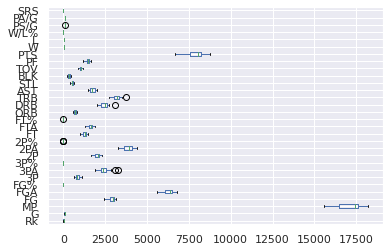

In [41]:
# Boxplot of variables dataset Team
df_team2.plot(kind='box', vert=False)

The dataset shows few outliers in the variables, indicating a balance among the teams.

#### Exploratory Questions <a name="subsubparagraph3"> 

###### What are the top teams?


Team
Dallas Mavericks*          8776
Milwaukee Bucks*           8663
Portland Trail Blazers*    8508
Houston Rockets*           8482
Los Angeles Clippers*      8377
New Orleans Pelicans       8341
Phoenix Suns               8294
Washington Wizards         8238
Memphis Grizzlies          8222
Boston Celtics*            8183
Name: PTS, dtype: int64


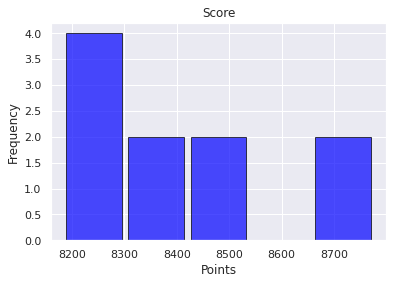

In [42]:
# Top 10 teams in relation to the number of points in the season
team_pts = df_team2.groupby(['Team'])["PTS"].sum().sort_values(ascending=False)[:10]
print(team_pts)

plt.title('Score')
plt.xlabel('Points')
plt.ylabel('Frequency')
plt.hist(team_pts, 5, rwidth=0.9, color='blue', alpha=0.7,    edgecolor='black')
plt.show()

Team
Los Angeles Lakers*       0.480
Indiana Pacers*           0.476
Milwaukee Bucks*          0.476
Denver Nuggets*           0.473
San Antonio Spurs         0.472
Utah Jazz*                0.471
Oklahoma City Thunder*    0.468
Miami Heat*               0.468
Memphis Grizzlies         0.468
Philadelphia 76ers*       0.468
Name: FG%, dtype: float64


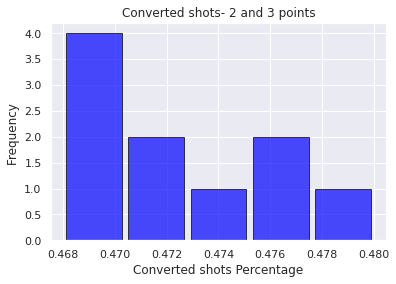

In [43]:
# Top 10 times em relação ao percentual de arremessos convertidos (2 e 3 pontos)
team_fgp = df_team2.groupby(['Team'])["FG%"].sum().sort_values(ascending=False)[:10]
print(team_fgp)

plt.title('Converted shots- 2 and 3 points')
plt.xlabel('Converted shots Percentage')
plt.ylabel('Frequency ')
plt.hist(team_fgp, 5, rwidth=0.9, color='blue', alpha=0.7,    edgecolor='black')
plt.show()

Team
Phoenix Suns               0.834
San Antonio Spurs          0.810
Portland Trail Blazers*    0.804
Golden State Warriors      0.803
Boston Celtics*            0.801
Toronto Raptors*           0.796
Oklahoma City Thunder*     0.796
Los Angeles Clippers*      0.791
Houston Rockets*           0.791
Atlanta Hawks              0.790
Name: FT%, dtype: float64


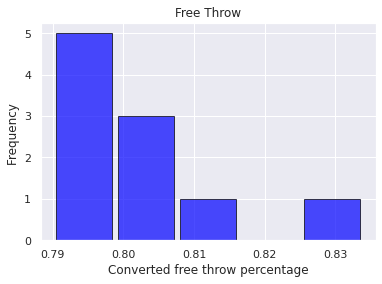

In [44]:
# Top 10 teams in free throws percentage
team_ftp = df_team2.groupby(['Team'])["FT%"].sum().sort_values(ascending=False)[:10]
print(team_ftp)

plt.title('Free Throw')
plt.xlabel('Converted free throw percentage')
plt.ylabel('Frequency ')
plt.hist(team_ftp, 5, rwidth=0.9, color='blue', alpha=0.7,    edgecolor='black')
plt.show()

Team
Milwaukee Bucks*           3774
Dallas Mavericks*          3520
Brooklyn Nets*             3449
Los Angeles Clippers*      3431
Memphis Grizzlies          3397
Portland Trail Blazers*    3353
New Orleans Pelicans       3348
Philadelphia 76ers*        3317
Boston Celtics*            3317
Toronto Raptors*           3268
Name: TRB, dtype: int64


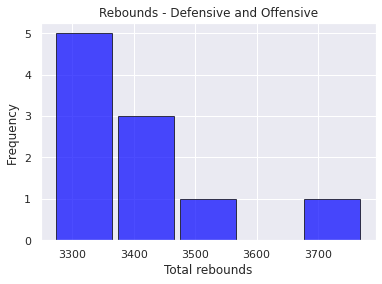

In [45]:
# Top 10 teams in relation to total rebounds
team_trb = df_team2.groupby(['Team'])["TRB"].sum().sort_values(ascending=False)[:10]
print(team_trb)

plt.title('Rebounds - Defensive and Offensive')
plt.xlabel('Total rebounds')
plt.ylabel('Frequency ')
plt.hist(team_trb, 5, rwidth=0.9, color='blue', alpha=0.7,    edgecolor='black')
plt.show()

Team
Utah Jazz*                 0.380
Miami Heat*                0.379
Portland Trail Blazers*    0.377
San Antonio Spurs          0.376
Toronto Raptors*           0.374
Los Angeles Clippers*      0.371
New Orleans Pelicans       0.370
Washington Wizards         0.368
Philadelphia 76ers*        0.368
Dallas Mavericks*          0.367
Name: 3P%, dtype: float64


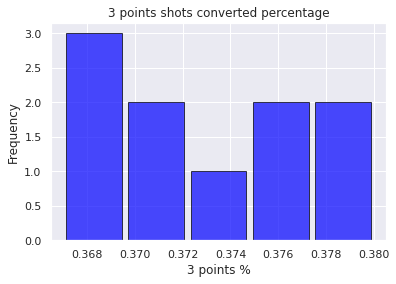

In [46]:
# Top 10 teams in relation to percentage of 3 points converted
team_3pp = df_team2.groupby(['Team'])["3P%"].sum().sort_values(ascending=False)[:10]
print(team_3pp)

plt.title('3 points shots converted percentage')
plt.xlabel('3 points %')
plt.ylabel('Frequency')
plt.hist(team_3pp, 5, rwidth=0.9, color='blue', alpha=0.7,    edgecolor='black')
plt.show()

It's interesting to note that the winning team of the season does not appear among the top 10 scorers but is in first 
This may indicate that making more points is not necessarily what leads to victory, but rather the quality of the shots. 

This may indicate that scoring more points is not necessarily what leads to victory but rather the quality of the shots. 

Is there a relationship between being "better" in a given variable and winning the season?

This is what we will verify through the correlation analysis between the variables. 

#### **Correlation between variables** <a name="subsubparagraph4">

A correlation is a mutual relationship or a connection between two variables. Which variables are most related to each other?



For a better correlation analysis I removed some variables that could give a false positive result for being variables already related to each other, such as:
* Amount of attempted throws and amount of converted throws. 
* Percentage of converted shots
* FG - which represents shots from 2 and 3 together
* Total rebounds with offensive and defensive rebounds
* Win-loss ratio

>**Remenber: correlation does not imply cause**

In [47]:
# creating the correlation matrix
df_tcorr = df_team2.copy()
df_tcorr.drop(['Rk','G', 'MP','W/L%', 'SRS','FG','FGA','FG%','2P%','3P%', '3PA','2PA', 'FTA', 'PS/G', 'PA/G','TRB'], axis=1, inplace=True)
corr_team = df_tcorr.corr()
corr_team.corr()

,3P,2P,FT,FT%,ORB,DRB,AST,STL,BLK,TOV,PF,PTS,W,L
3P,1.000000,0.106251,0.787306,0.224531,0.121092,0.762893,0.399948,-0.005496,0.461307,0.494649,0.662803,0.792268,0.728808,-0.720793
2P,0.106251,1.000000,0.403522,0.141455,0.296852,0.689366,0.804205,0.284748,0.769647,0.040807,0.530099,0.680112,0.679748,-0.640624
FT,0.787306,0.403522,1.000000,0.646673,-0.142855,0.791288,0.499282,0.185139,0.629195,0.168569,0.733879,0.876805,0.805452,-0.781385
FT%,0.224531,0.141455,0.646673,1.000000,-0.647830,0.184760,0.114712,0.150241,0.123914,-0.309483,0.297983,0.342816,0.268838,-0.239913
ORB,0.121092,0.296852,-0.142855,-0.647830,1.000000,0.251012,0.235104,-0.100904,0.274076,0.193380,0.263594,0.195226,0.156855,-0.138911
DRB,0.762893,0.689366,0.791288,0.184760,0.251012,1.000000,0.776291,0.103897,0.824033,0.391767,0.702118,0.969727,0.953810,-0.932297
AST,0.399948,0.804205,0.499282,0.114712,0.235104,0.776291,1.000000,0.295002,0.611480,0.464240,0.594608,0.762468,0.762794,-0.731444
STL,-0.005496,0.284748,0.185139,0.150241,-0.100904,0.103897,0.295002,1.000000,0.380060,0.045673,0.369883,0.188784,0.341669,-0.375224
BLK,0.461307,0.769647,0.629195,0.123914,0.274076,0.824033,0.611480,0.380060,1.000000,0.014845,0.580421,0.806988,0.843197,-0.833910
TOV,0.494649,0.040807,0.168569,-0.309483,0.193380,0.391767,0.464240,0.045673,0.014845,1.000000,0.419366,0.337539,0.349386,-0.361795


For a better visualization let's make the *heatmap*.

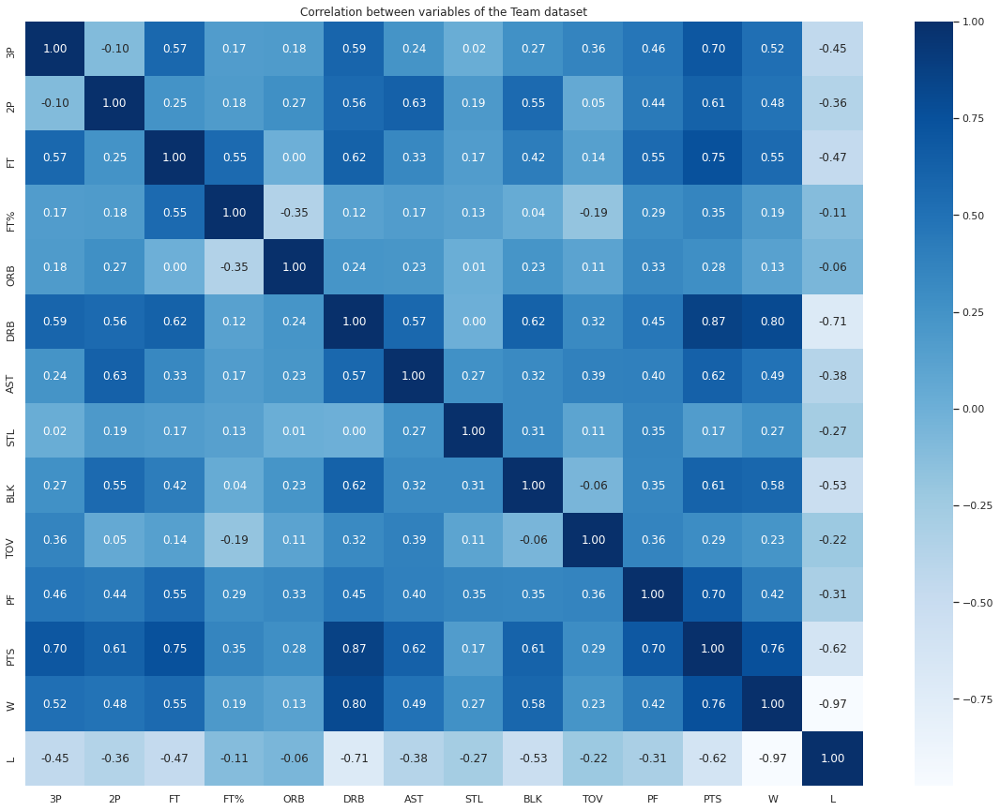

In [48]:
# creating heatmap
plt.figure(figsize=(20, 15))
sns.heatmap(corr_team,
            annot = True,
            fmt = '.2f',
            cmap='Blues')
plt.title('Correlation between variables of the Team dataset')
plt.show()

Para melhorar ainda mais a visualização vamos focar nas variáveis que possuem mais correlação com a variável *Wins* que reprenta as vitórias.

In [49]:
# correlation Team
k = 10

# finding the most correlated variables
cols = corr_team.nlargest(k, 'W')['W'].index
cm = np.corrcoef(corr_team[cols].values.T)

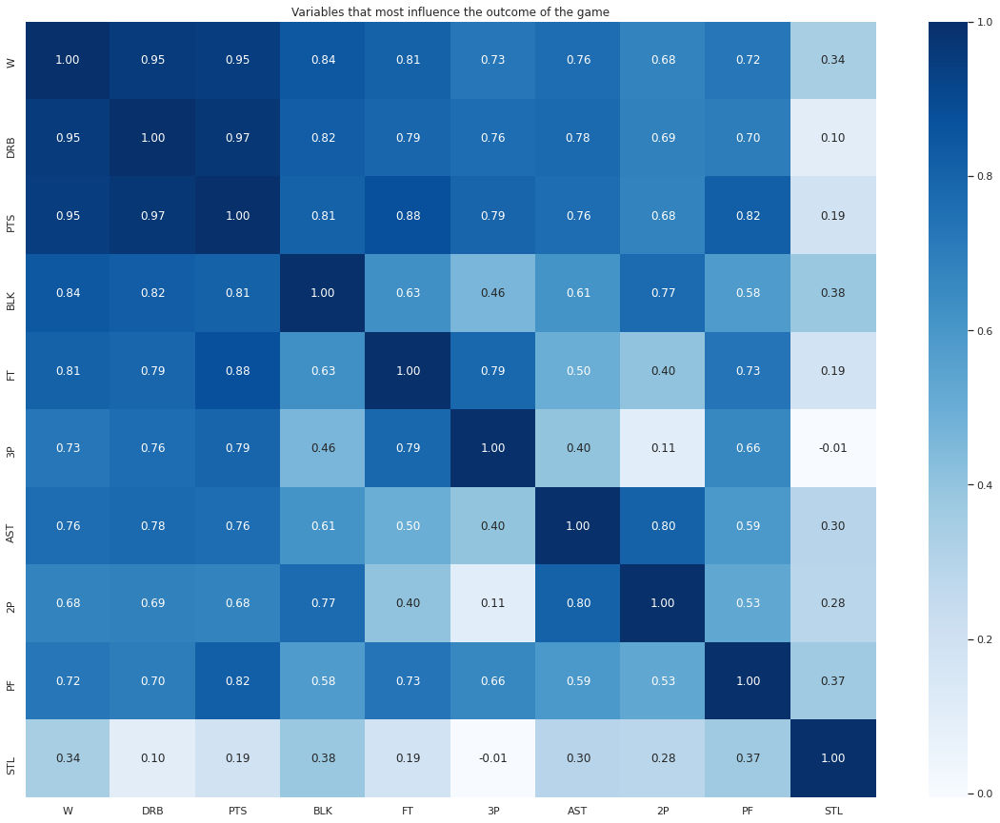

In [50]:
# creating heatmap
plt.figure(figsize=(20, 15))
sns.heatmap(cm,
            annot = True,
            fmt = '.2f',
            cmap='Blues',
            yticklabels=cols.values, xticklabels=cols.values)
plt.title('Variables that most influence the outcome of the game')
plt.show()

Table with the 9 variables that most influence the variable *Win*, which represents the number of wins the team has in the season.

|Variable| Value ||
|----------------|-------------------------------|-----------------------------|
|DBR | o,95
|PTS | 0,95
|BKL | 0,84
|FT | 0,81
|AST | 0,76
|3P | 0,73
|PF | 0,72
|2P | 0,68
|STL | 0,32

Interesting observations: 
* The defense variables defensive rebounding and blocking have high correlation in relation to the wins variable. 
* As expected the variable point has a positive relationship with the wins.
* Free throws for being a ball theoretically easier to be converted also has a high correlation. And as we saw earlier, the average percentage of shots converted is 77%, a high percentage. 
* Long shots that are the 3 point baskets are also highly correlated with victory. 

Vimos que pontos é uma variável importe e altamente correlacionada com a variável vitória. 
Vamos então analisar as variáveis que mais influenciam a variável pontos.

In [51]:
# analyzing the variable points
# number of variables to be selected
k = 10

# finding the most correlated variables
cols = corr_team.nlargest(k, 'PTS')['PTS'].index
cm = np.corrcoef(corr_team[cols].values.T)

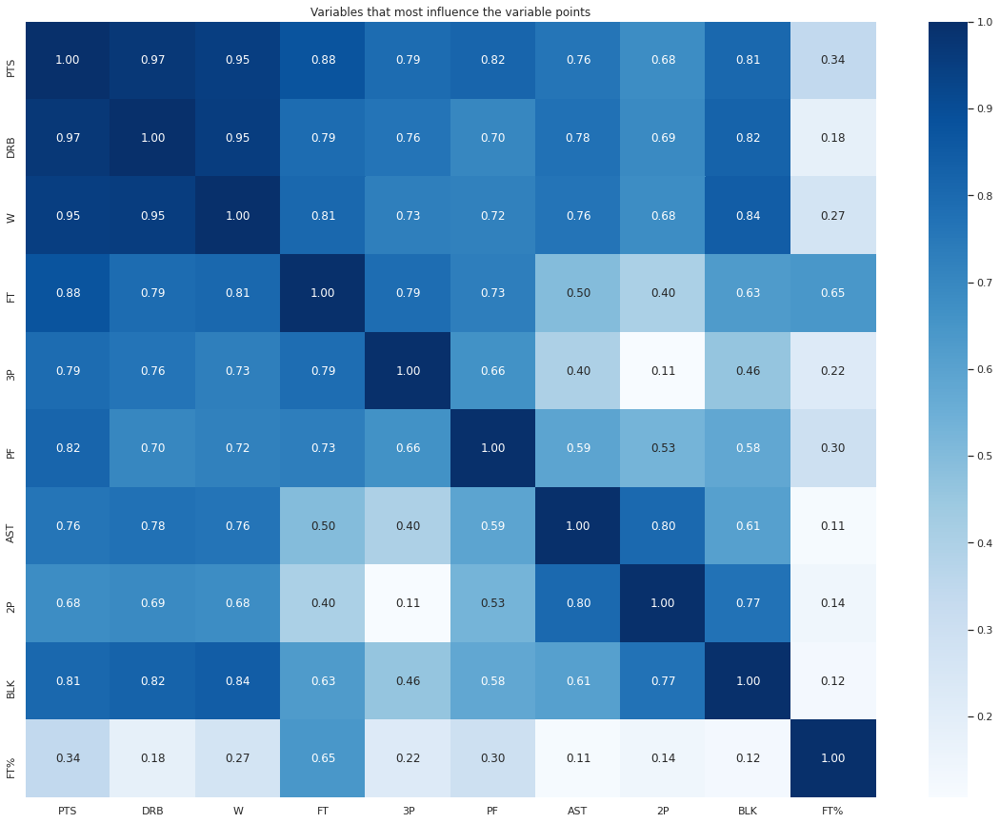

In [52]:
# creating heatmap
plt.figure(figsize=(20, 15))
sns.heatmap(cm,
            annot = True,
            fmt = '.2f',
            cmap='Blues',
            yticklabels=cols.values, xticklabels=cols.values)
plt.title('Variables that most influence the variable points')
plt.show()

Variables most related to the variable points:

|Variable| Value ||
|----------------|-------------------------------|-----------------------------|
|DRB | 0.97
W | 0.95
FT | 0.88
PF | 0.82
BLK | 0.81
3P | 0.79
AST | 0.76
2P | 0.68
FT% | 0.34

Once again we see that defense-related variables are important and make a difference in the score. 

Many times, by grabbing the rebound, the team has an advantage.

If it is an offensive rebound, the player is closer to the table, is usually a taller player, and runs the risk of being fouled. 

As for the defensive rebound, it is likely to get a long pass to the player further forward, facilitating the conversion of the shot. 



Historically, 3-point attempts have exceeded 2-point attempts because, according to the teams' analysts, more 3-point attempts have a higher relation with the number of victories. 

Over the years of the NBA, teams started to worry about the efficiency of 3-point shots and started to adopt long shots as a game strategy, starting a change in the pattern of the game.

Houston Rockets have been breaking the record for shots per game since the 16/17 season, but we cannot leave aside the "Splash Brothers", Stephen Curry and Klay Thompson, who are surprisingly quick to open scoreboard advantage.  

> **We can see then that the "3P" variable actually outperforms the "2P" when correlated with the points variable, which in turn is highly correlated with the wins variable.**

---

---

### Pandas - Profiling <a name="subparagraph2"> </a>  ([&uArr;](#sumario))

An easier and more practical alternative to perform a descriptive analysis of the data is to use **Pandas Profiling**.

It generates a report in HTML format with all the necessary information, making it easier for us to visualize the data. 

Some information that it brings us:
* Size of the dataset 
* Number of duplicated lines.
* The type of data in each column
* Which columns contain missiing values
* ***Warnings***

In *warnings* it tells us some information that we need to pay more attention to related to our dataset, such as degree of correlation between variables, normality of the data, unique values, etc. 

At *variables* it gives information for each variable as if we were using df_team2.describe() and also gives histograms with the frequency distribution. 

It also shows us the correction matrix of the variables. 

Best of all, we can save the report in html format for later use.   


Using Pandas - Profiling

Installation instructions can be found [here](https://github.com/pandas-profiling/pandas-profiling#installation).

In [53]:
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
  Created wheel for pandas-profiling: filename=pandas_profiling-2.12.0-py2.py3-none-any.whl size=243829 sha256=0a38efd273d253bf81efa6c0d08acb90d34823b9ff225b5b5519a6781ddef548
  Stored in directory: /tmp/pip-ephem-wheel-cache-jv82wm22/wheels/56/c2/dd/8d945b0443c35df7d5f62fa9e9ae105a2d8b286302b92e0109
Successfully built pandas-profiling


In [54]:
# importing Pandas Profiling
from pandas_profiling import ProfileReport

In [55]:
# creating ProfileReport
report = ProfileReport(df_team2, title="Análise Times NBA - 2019-2020")

In [56]:
# creating iframe preview
report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/46 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [57]:
# saving the report
report.to_file(output_file="Análise Times NBA - 2019-2020.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## Conclusions <a name="paragraph3"></a> ([&uArr;](#summary))

> We can conclude that although the conversion of 3-point shots on intuition seems more difficult in reality it is an important variable for the team's victory. 

> Defense variables have a great correlation with wins and points. An efficient defensive strategy can make a difference in the game. 

> Free throws are also important, because they are theoretically easier to be converted since the player has no opponent getting in the way.

## Final Considerations<a name="paragraph4"></a> ([&uArr;](#summary))

For a future analysis it would be interesting to check in more detail the efficiency of the teams related to the variables.

Among the teams that made it to the playoffs, would there be any similarities between your data (question)

The relationship of the team with the amount of rebounds or assists can indicate the style of play of the team, a more individual or more collective game. 

Do teams from the same conference have similar characteristics?

## Curiosity<a name="paragraph5"> </a> ([&uArr;](#summary))

## Thank you!</a> ([&uArr;](#summary))

Thank you for getting this far! 

I hope the reading and the results have been interesting and useful. 


[<center><img alt="LinkedIn" width="20%" src="https://www.freepnglogos.com/uploads/linkedin-png-logo-23.png
"></center>](https://www.linkedin.com/in/bianca-rodrigues-isaac/) 

[<center><img alt="Medium" width="20%" src="https://miro.medium.com/max/8978/1*s986xIGqhfsN8U--09_AdA.png
"></center>](https://medium.com/@biancarisaac)